# Exploration of Noah's 7777 'everyday' photos

This notebook contains some additional explorations I did after all of Noah's 'photos from the 'everyday' project were aligned. It was those aligned photos that then were used to create Noah's most recent 'everyday' video [7777](https://www.youtube.com/watch?v=DC1KHAxE7mo).

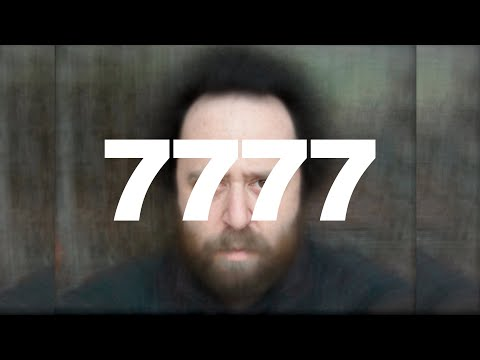

In [1]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('DC1KHAxE7mo')

# Prepare everything

As always, let's first import some libraries we will need later on.

In [2]:
import os
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
import imageio
import cv2
from skimage.transform import resize
from tqdm.notebook import tqdm
import tensorflow as tf

%matplotlib inline

# 1. Prepare images

The aligned photos are all in 4k resolution. That is too much detail for a 'quick' data exploration. Therefore, this step is trying to find a reasonable downsampling resolution.

In [3]:
# Collect all images
imgs = sorted(glob("img_aligned/20*"))

print(f"We found {len(imgs)} images.")

We found 7777 images.


Each image has the shape (2160, 3840, 3), where the last dimension are the 3 RGB color channels.


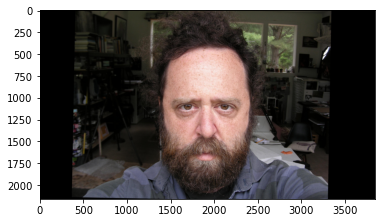

In [4]:
# Plot the last of these images
last_img = imageio.imread(imgs[-1])
plt.imshow(last_img)
print(
    f"Each image has the shape {last_img.shape}, where the last dimension are the 3 RGB color channels."
)

Machine learning models love a lot of data, but images in 4k resolution might nonetheless push it a bit. So let's resize this to something a bit more compact and let's make the image shape squared. This is not really required, just a data science habbit.

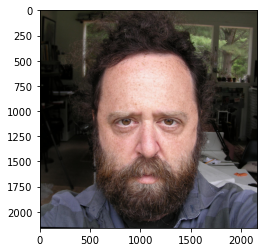

In [5]:
# Get image height and width
height, width = last_img.shape[:2]

# Crop image to a squared shape, centered in the middle
offset = (width - height) // 2
img_squared = last_img[:, offset:-offset, :]

# Plot the cropped image version
plt.imshow(img_squared);

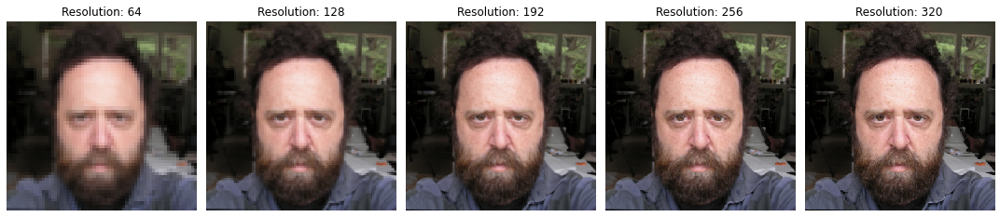

In [6]:
# Let's explore different resizing shapes
resolutions = [64 + i * 64 for i in range(5)]

fig, axes = plt.subplots(1, len(resolutions), figsize=(3 * len(resolutions), 4))
for i, res in enumerate(resolutions):
    axes[i].set_title(f"Resolution: {res}")
    axes[i].imshow(resize(img_squared, (res, res)), interpolation='nearest')
    axes[i].axis("off")
plt.tight_layout()

64 x 64 pixels is definitely too small. Let's go with 256 for now. As the following image shows, the resolution is good enough to see some smallish details, but also small enough to keep the data dimension (256 * 256 * 3 = 196,608 pixel values) to something almost 'manageable'.

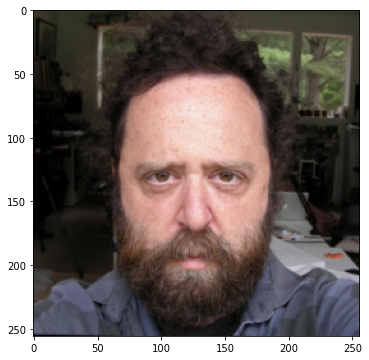

In [7]:
res = 256
plt.figure(figsize=(6, 6))
plt.imshow(resize(img_squared, (res, res)));

So now that we have explored all this. Let's go ahead and preapre the whole dataset. We will take the aligned 4k photos, crop the images to a square and downsize them to 256 x 256 pixels.

In [8]:
# Create output folder for AI prepared images
out_dir = "img_AI"
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

# Define image resolution
res = 256

# Prepare images and store them in new folder
for i in tqdm(range(len(imgs))):

    # Define file output name
    out_file = os.path.join(out_dir, f"img_{i+1:04d}.png")

    # Create image if it doesn't yet exist
    if not os.path.exists(out_file):

        #  Transform image
        img = (
            255 * resize(imageio.imread(imgs[i])[:, offset:-offset, :], (res, res))
        ).astype("uint8")

        # Store transformed file
        imageio.imwrite(out_file, img)

  0%|          | 0/7777 [00:00<?, ?it/s]

# 2. Load dataset (and have some fun)

Now that the data is prepared and stored on the hard drive, let's load all of it into memory and have some fun with some data exploration :-)

In [9]:
data = np.array(
    [imageio.imread(d) for d in tqdm(sorted(glob(os.path.join(out_dir, "*png"))))]
)

  0%|          | 0/7777 [00:00<?, ?it/s]

## 2.1. Yearly average collage

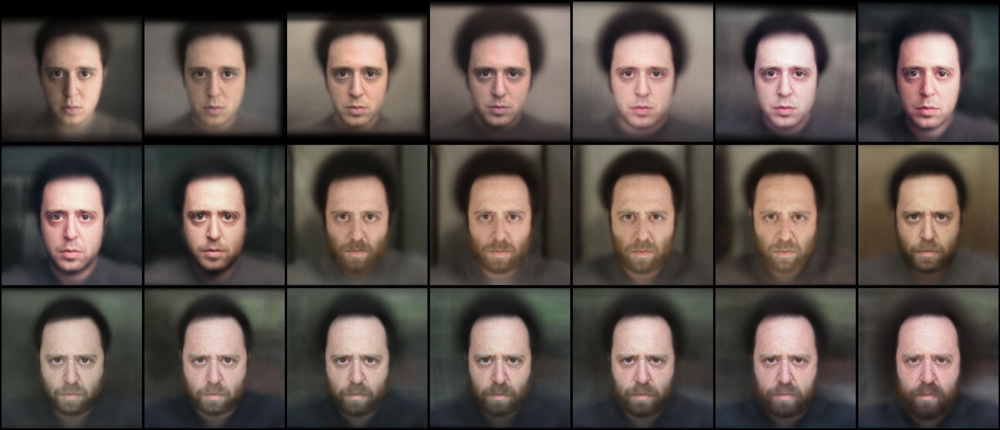

In [10]:
# Plot a grid of certain size of first x images
grid_size = (3, 7)
grid_points = np.prod(grid_size)
imgs_averages = np.array_split(data, grid_points)
fig, axes = plt.subplots(
    grid_size[0], grid_size[1], figsize=(60, 26), facecolor=(0, 0, 0)
)
for i, ax in zip(np.arange(grid_points), axes.flatten()):
    ax.imshow(imgs_averages[i].mean(0).astype("int"))
    ax.axis("off")
plt.tight_layout()

**Note**, each of this picture is the average of roughly 1 year!

## 2.2. Full pixel collage

What about taking the pixels in an image, flattening them to a huge vertical column and concatenating all of the 7777 pixel columns horizontally?

In [11]:
pixel_imgs = np.reshape(data, (len(data), -1, 3))

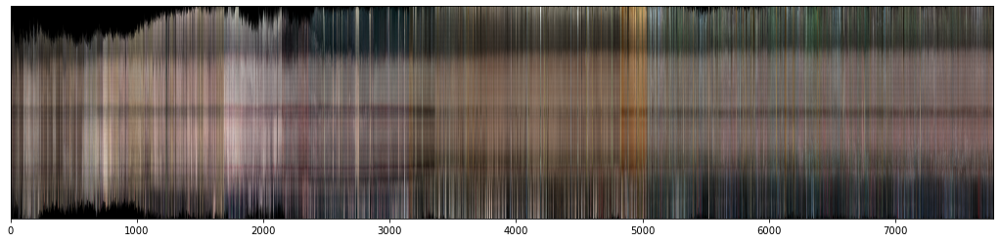

In [12]:
plt.figure(figsize=(18, 4))
plt.imshow(np.rollaxis(pixel_imgs[:, ::5, :], 1, 0).astype("int"), aspect="auto");
plt.yticks([]);

## 2.3. 21 year in 21 seconds gif

As a homage to my first tweet about this project, let's create a gif of all alligned 7777 photos and loop through them in 21 seconds (i.e. 1 year per second). And as in the original post, let's average for each frame 60 images at once.

In [13]:
n_steps = 12
smooth = 60
imgs_average = []
for i in tqdm(range(len(data)//n_steps)):
    new_average = np.mean(data[i*n_steps:i*n_steps+smooth, ...], axis=0)
    imgs_average.append(new_average)
imgs_average = np.array(imgs_average)
imgs_average.shape

  0%|          | 0/648 [00:00<?, ?it/s]

(648, 256, 256, 3)

In [14]:
# Save images in gif - every second is one year, and the average is covering 6 months
from imageio import mimwrite
mimwrite('noah_average_new.gif', imgs_average.astype('uint8'), format='gif', fps=30)

from IPython.display import Image
Image(url='noah_average_new.gif', width=400)

## 2.4. Investigate time course correlations

'Fun' is definitely in the eye of the beholder, but what we want to do in this step is explore if there are particular temporal characteristics in 'everyday'. To reduce the memory load of this, let's focus on grayscale images only.

In [15]:
def rgb2gray(rgb):
    """Function to transform RGB images into grayscale"""
    return np.dot(rgb[..., :3], [0.2989, 0.5870, 0.1140])

In [16]:
# Create gray scale data
data_gray = np.array([rgb2gray(d) for d in tqdm(data)]) / 255.0

  0%|          | 0/7777 [00:00<?, ?it/s]

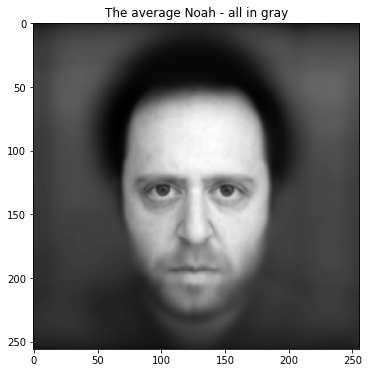

In [17]:
plt.figure(figsize=(6, 6))
plt.imshow(data_gray.mean(0), cmap="gray")
plt.title("The average Noah - all in gray")
plt.show()

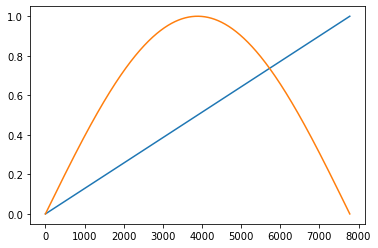

In [18]:
# Create different time courses
x_linear = np.linspace(0, 1, len(data))
x_bell = np.sin(x_linear * np.pi)

# Plot different time course plots
plt.plot(x_linear)
plt.plot(x_bell)
plt.show()

These two curves are our 'temporal change of interest'. Meaning, the linear investigation will check what has linearly increased through time, while the 2nd one (the orange) curve will look at what has changed until the middle of the 7777 photos and then decrease again.

In [19]:
def compute_change(data, time_curve):
    """This function computes the pixel wise correlation with the time_curve
    and provides an informative output figure where each pixel represents
    the is pearson correlation r coefficient."""

    data_flat = data.reshape(len(data), -1)

    change = [
        np.corrcoef(data_flat[:, i], time_curve)[0, 1]
        for i in tqdm(range(data_flat.shape[1]))
    ]
    change = np.array(change).reshape(data.shape[1:])
    return (change + 1) / 2

### Estimate linear change and plot it

In [20]:
change_linear = compute_change(data_gray, x_linear)

  0%|          | 0/65536 [00:00<?, ?it/s]

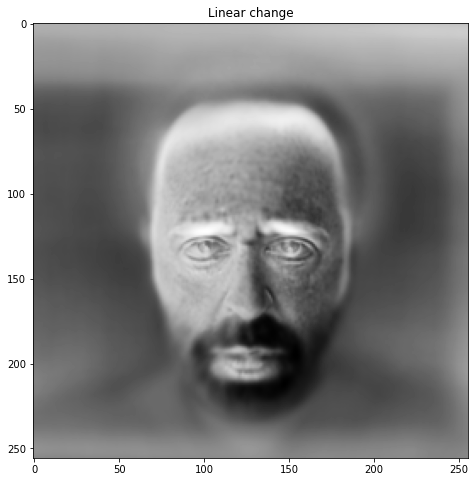

In [21]:
plt.figure(figsize=(8, 8))
plt.imshow(change_linear, cmap="gray")
plt.title("Linear change")
plt.show()

### Estimate 'bell' change and plot it

In [22]:
change_bell = compute_change(data_gray, x_bell)

  0%|          | 0/65536 [00:00<?, ?it/s]

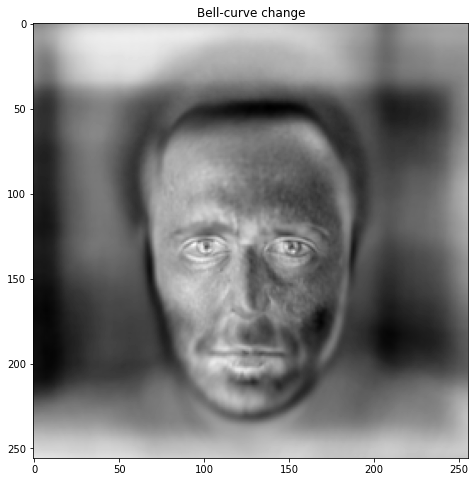

In [23]:
plt.figure(figsize=(8, 8))
plt.imshow(change_bell, cmap="gray")
plt.title("Bell-curve change")
plt.show()

# 3. Dimensionality reduction

To better understand how the images relate to each other, let's look at two ways of projecting the images from a high-dimensional space (i.e. 256 x 256 pixels = 65536 dimenions), down to two dimensions. To do so, we will use principal component analysis (PCA) and UMAP.

In [24]:
# Validate once more the shape of the grayscale images
data_gray.shape

(7777, 256, 256)

In [25]:
# Flatten grayscale images
X = np.reshape(data_gray, (len(data_gray), -1))
X.shape

(7777, 65536)

In [26]:
# Downsample the color images by 2 to reduce memory footpring
data_small = data[:, ::2, ::2, :] / 255.0
data_small.shape

(7777, 128, 128, 3)

In [27]:
# Flatten color images
X_small = np.reshape(data_small, (len(data_small), -1))
X_small.shape

(7777, 49152)

In [28]:
# Establish a supportive 'age' variable
age = np.linspace(0, 21, len(data), endpoint=False, dtype="int")
age

array([ 0,  0,  0, ..., 20, 20, 20])

## 3.1. Principal Component Analysis (PCA)

In [29]:
# Specify how many PCA components should be kept
n_comp = 50

In [30]:
from sklearn.decomposition import PCA

### PCA with gray scale images

In [31]:
# Compute PCA components
pca = PCA(n_comp)
%time X_pca = pca.fit_transform(X)

CPU times: user 2min 28s, sys: 25 s, total: 2min 53s
Wall time: 54.3 s


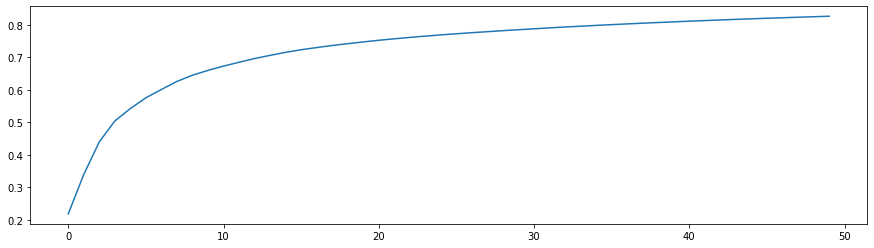

In [32]:
# Show scree plot
plt.figure(figsize=(15, 4))
plt.plot(pca.explained_variance_ratio_.cumsum())
plt.show()

In [33]:
# How much variance is explained by first X components
pca.explained_variance_ratio_.sum()

0.8265846099438869

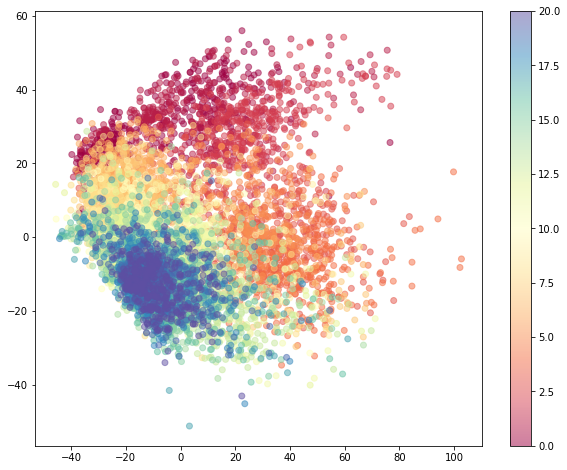

In [34]:
# Plot first two PCA components with image index color coded
plt.figure(figsize=(10, 8))
plt.scatter(
    X_pca[:, 0],
    X_pca[:, 1],
    c=age,
    alpha=0.5,
    cmap="Spectral",
)
plt.colorbar();

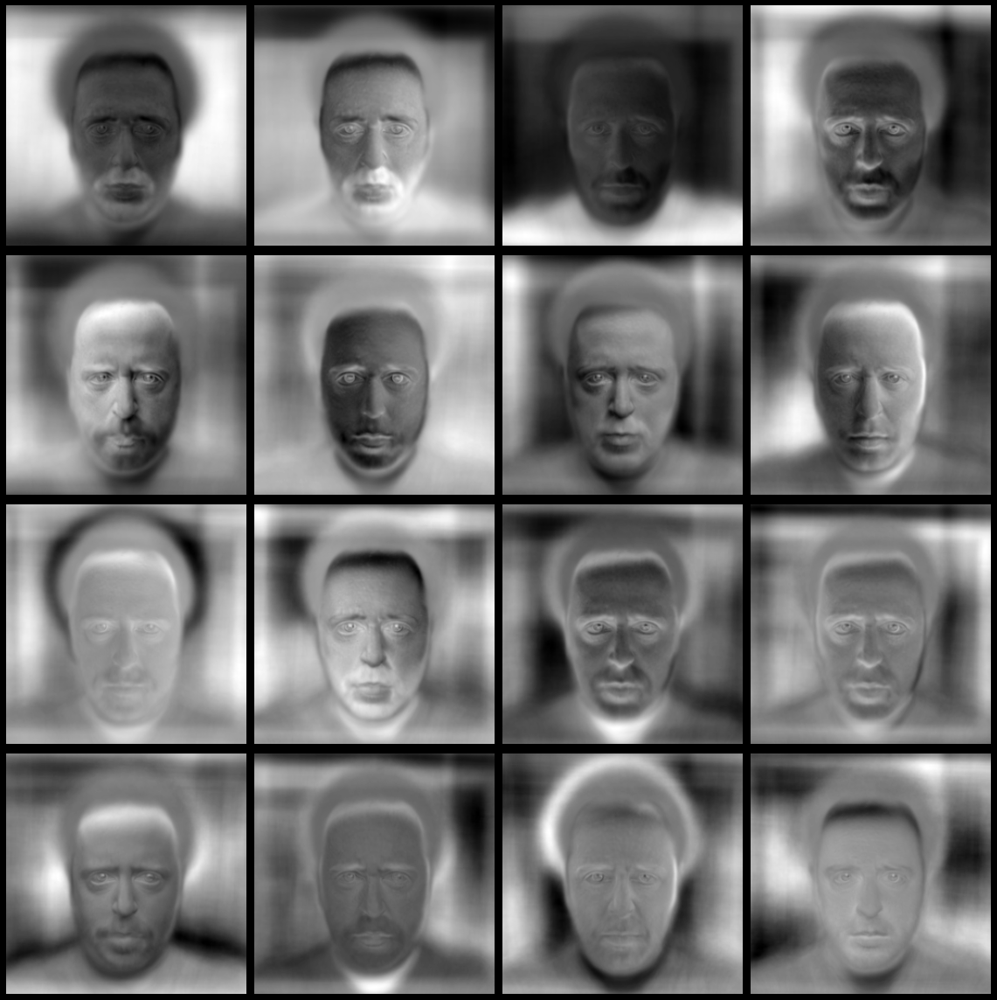

In [35]:
# Plot the first few PCA components as images
components = np.reshape(pca.components_, (pca.n_components_, *data_gray.shape[1:]))
fig, axes = plt.subplots(4, 4, figsize=(16, 16), facecolor=(0, 0, 0))
for i, ax in zip(np.arange(16), axes.flatten()):
    comp = components[i] - components[i].min()
    comp /= comp.max()
    ax.imshow(comp, cmap="gray")
    ax.axis("off")
plt.tight_layout()

### PCA with color scale images

In [36]:
# Compute PCA components
pca_small = PCA(n_comp)
%time X_pca_small = pca_small.fit_transform(X_small)

CPU times: user 1min 44s, sys: 9.37 s, total: 1min 54s
Wall time: 29.9 s


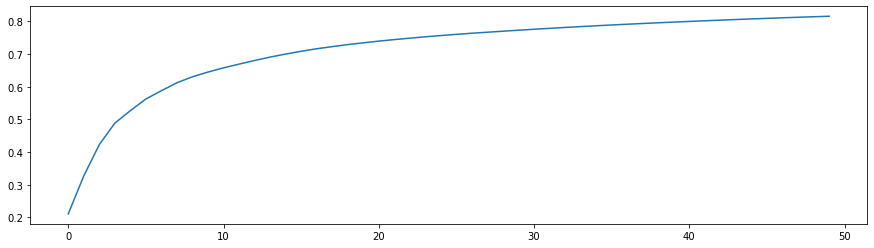

In [37]:
# Show scree plot
plt.figure(figsize=(15, 4))
plt.plot(pca_small.explained_variance_ratio_.cumsum())
plt.show()

In [38]:
# How much variance is explained by first X components
pca_small.explained_variance_ratio_.sum()

0.8160243574048482

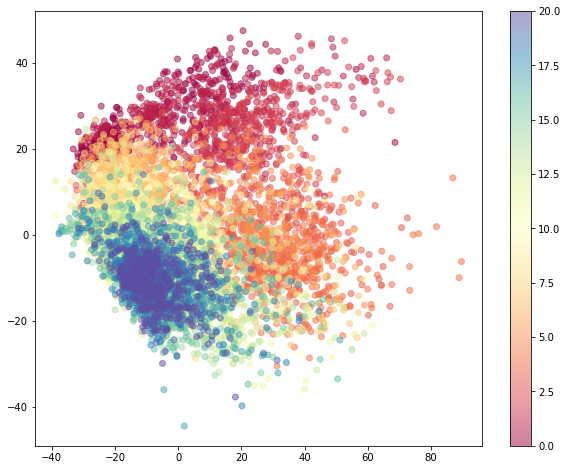

In [39]:
# Plot first two PCA components with image index color coded
plt.figure(figsize=(10, 8))
plt.scatter(
    X_pca_small[:, 0],
    X_pca_small[:, 1],
    c=age,
    alpha=0.5,
    cmap="Spectral",
)
plt.colorbar();

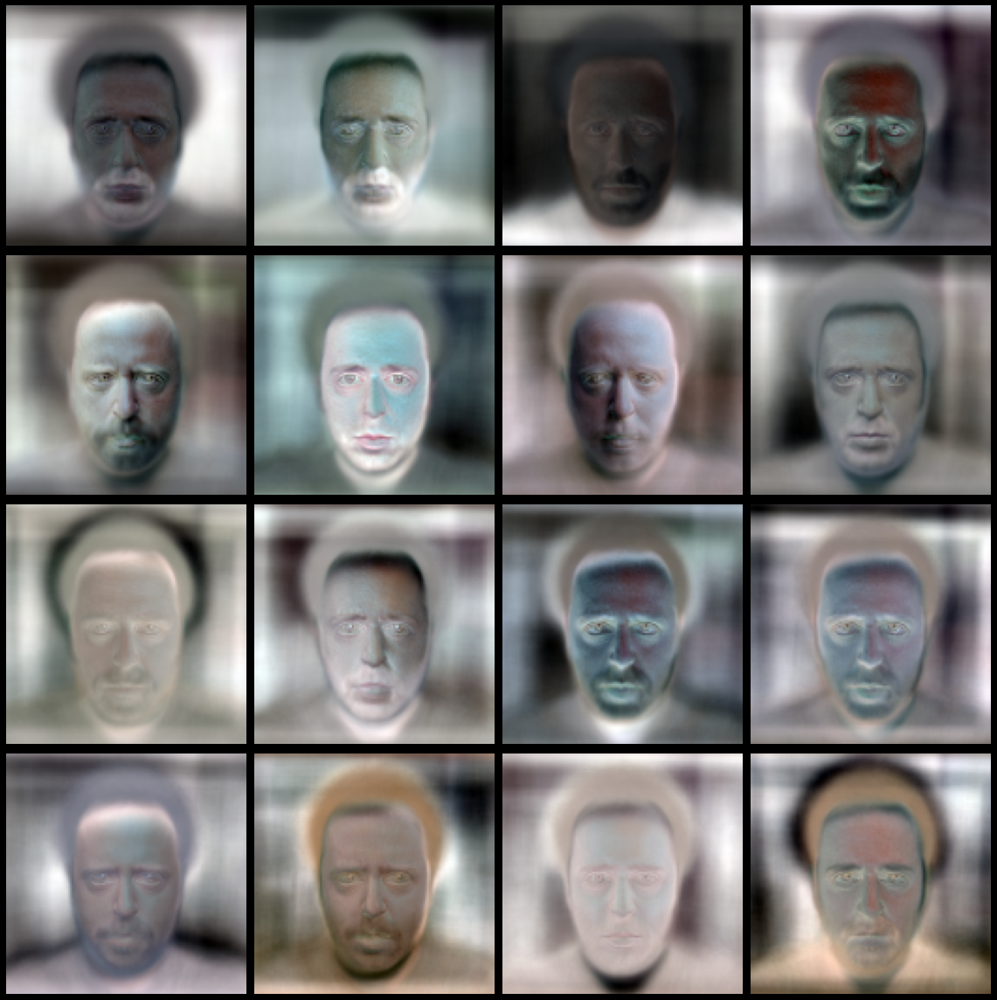

In [40]:
# Plot the first few PCA components as images
components = np.reshape(
    pca_small.components_, (pca_small.n_components_, *data_small.shape[1:])
)
fig, axes = plt.subplots(4, 4, figsize=(16, 16), facecolor=(0, 0, 0))
for i, ax in zip(np.arange(16), axes.flatten()):
    comp = components[i] - components[i].min((0, 1))
    comp /= comp.max((0, 1))
    ax.imshow(comp, cmap="gray")
    ax.axis("off")
plt.tight_layout()

## 3.2. UMAP

UMAP is another AI approach of how high-dimensional data can be projected down to just a few dimensions (here 2D). In contrast to PCA, where the dimensions are reduced into the direction of most explained variance, with UMAP, the reduction is done in such a way that the points keep the relative distance to each other.

In other words, with UMAP, points in N-dimensional space that were far apart are still far apart, and points that were close are still close.

In [41]:
from umap import UMAP

### UMAP on grayscale

In [42]:
# Let's compute UMAP projection based on the PCA reduced features
umap = UMAP(n_neighbors=15, min_dist=1)
%time X_umap = umap.fit_transform(X_pca)

CPU times: user 36.7 s, sys: 305 ms, total: 37 s
Wall time: 15.9 s


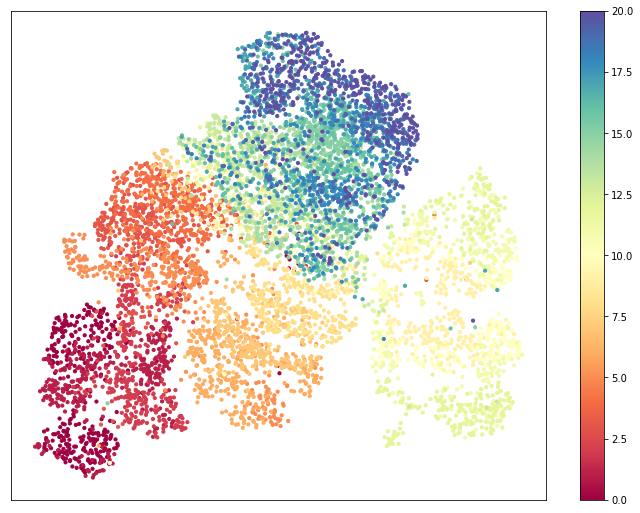

In [43]:
# Let's plot the UMAP projection
plt.figure(figsize=(12, 9))
plt.scatter(X_umap[:, 0], X_umap[:, 1], c=age, cmap="Spectral", s=10)
plt.colorbar()
plt.yticks([])
plt.xticks([]);

([], [])

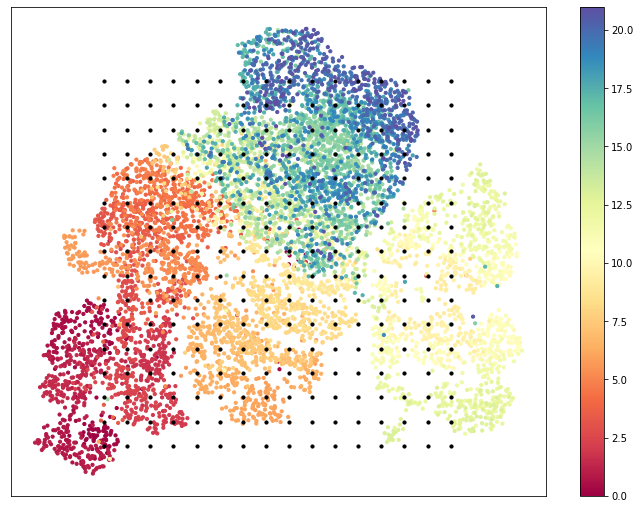

In [44]:
# Let's plot the UMAP projection with a equally spaced target grid
NN = 16
grid = np.array(
    [(i, j) for i in np.linspace(-4, 14, NN) for j in np.linspace(-3, 17, NN)]
)

plt.figure(figsize=(12, 9))
plt.scatter(
    X_umap[:, 0], X_umap[:, 1], c=np.linspace(0, 21, len(data)), cmap="Spectral", s=10
)
plt.colorbar()
plt.scatter(*grid.T, s=10, c="k")

plt.yticks([])
plt.xticks([]);

In [45]:
# Invert UMAP projection for target grid
%time inv_umap = umap.inverse_transform(grid)

CPU times: user 9.92 s, sys: 63.7 ms, total: 9.98 s
Wall time: 9.77 s


In [46]:
# Reverse PCA dimensionality reduction
faces = np.array(
    [p.reshape(data_gray.shape[1:]) for p in pca.inverse_transform(inv_umap)]
)

In [47]:
# Flip horizontal ordering of faces
faces = faces.reshape(NN, NN, *faces.shape[1:])[:, ::-1, ...].reshape(
    -1, *faces.shape[1:]
)

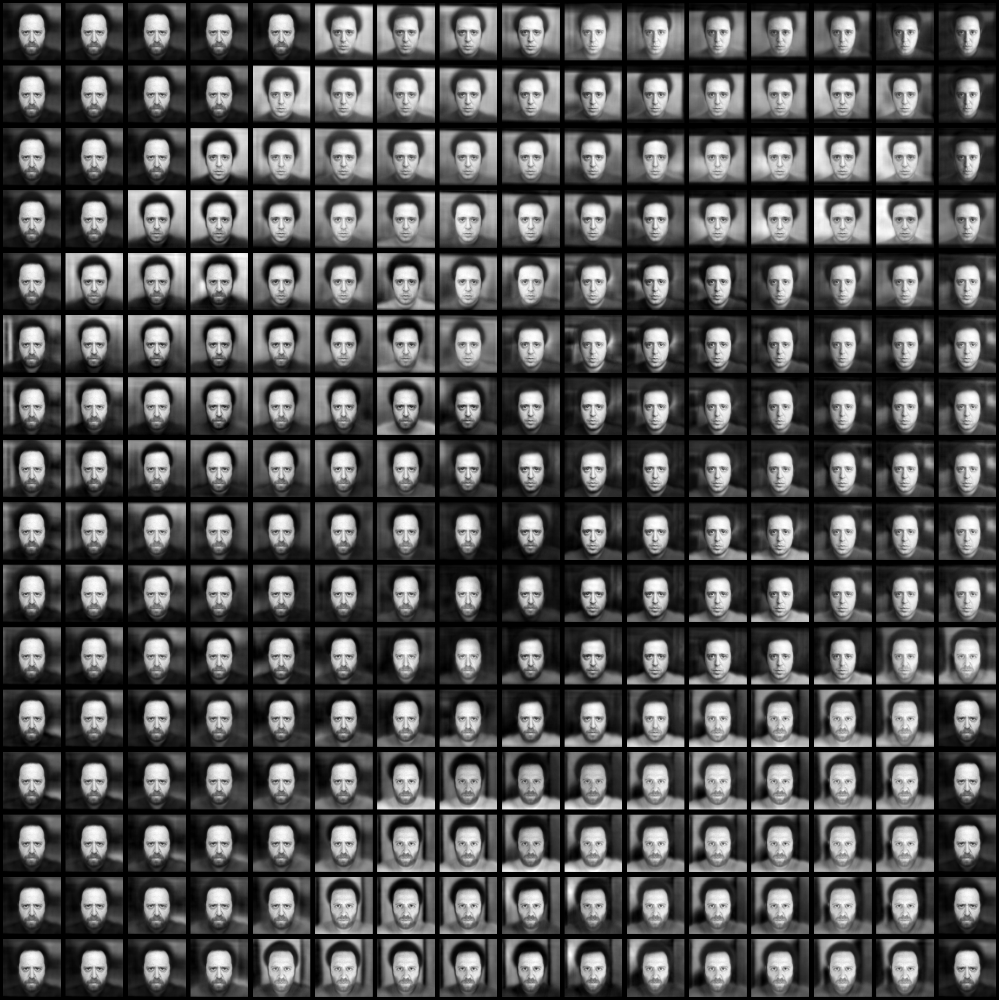

In [48]:
# Plot a grid of certain size of first x images
fig, axes = plt.subplots(16, 16, figsize=(30, 30), facecolor=(0, 0, 0))
for face, ax in zip(faces, axes.flatten()):
    ax.imshow(face, cmap="gray")
    ax.axis("off")
plt.tight_layout()

### Circle exploration of UMAP projection of grayscale images

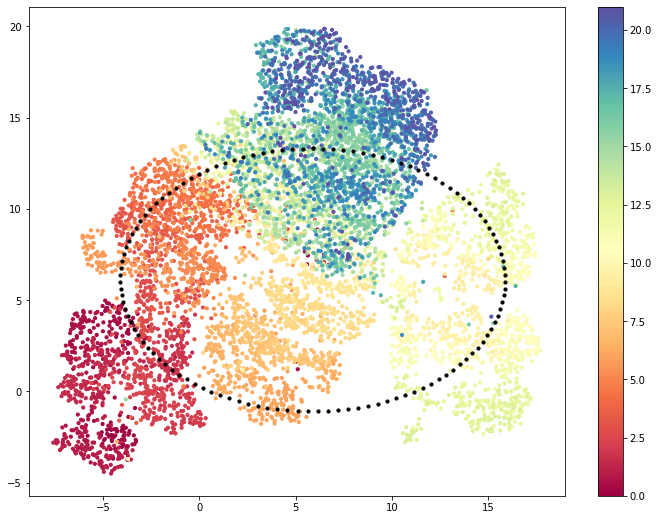

In [57]:
N = 120
circle = np.array([[np.sin(p), np.cos(p)] for p in np.linspace(0, np.pi * 2, N)])
circle *= 8
circle[:, 0] = circle[:, 0] * 1.25
circle[:, 1] = circle[:, 1] * 0.9
circle[:, 0] = circle[:, 0] + 1
circle[:, 1] = circle[:, 1] - 2
circle += X_umap.mean(0)

plt.figure(figsize=(12, 9))
plt.scatter(
    X_umap[:, 0], X_umap[:, 1], c=np.linspace(0, 21, len(data)), cmap="Spectral", s=10
)
plt.colorbar()
plt.scatter(*circle.T, s=10, c="k");

In [58]:
# Invert UMAP projection for target grid
%time inv_umap = umap.inverse_transform(circle)

CPU times: user 7.47 s, sys: 37.8 ms, total: 7.51 s
Wall time: 7.3 s


In [59]:
# Reverse PCA dimensionality reduction
faces = np.array(
    [
        p.reshape(data_gray.shape[1:]).clip(min=0, max=1)
        for p in pca.inverse_transform(inv_umap)
    ]
)

In [60]:
# Increase size of images to have nicer output gif
faces = np.array(
    [cv2.resize(f, tuple(np.array(faces.shape[1:3]) * 2)) for f in tqdm(faces)]
)

  0%|          | 0/120 [00:00<?, ?it/s]

In [61]:
# Save images in gif
from imageio import mimwrite

mimwrite("noah_umap_circle_gray.gif", (255 * faces).astype("uint8"), format="gif", fps=12)

In [62]:
from IPython.display import Image

Image(url="noah_umap_circle_gray.gif", width=400)

### UMAP on color images

In [63]:
# Let's compute UMAP projection based on the PCA reduced features
umap_small = UMAP(n_neighbors=15, min_dist=1)
%time X_umap_small = umap_small.fit_transform(X_pca_small)

CPU times: user 28.3 s, sys: 378 ms, total: 28.7 s
Wall time: 6.27 s


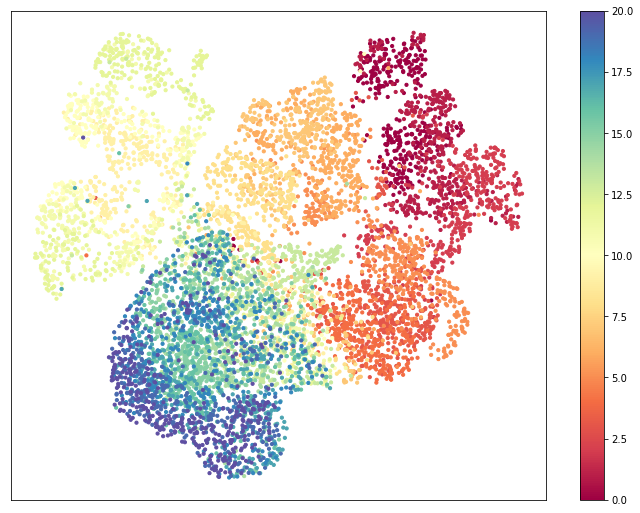

In [64]:
# Let's plot the UMAP projection
plt.figure(figsize=(12, 9))
plt.scatter(X_umap_small[:, 0], X_umap_small[:, 1], c=age, cmap="Spectral", s=10)
plt.colorbar()
plt.yticks([])
plt.xticks([]);

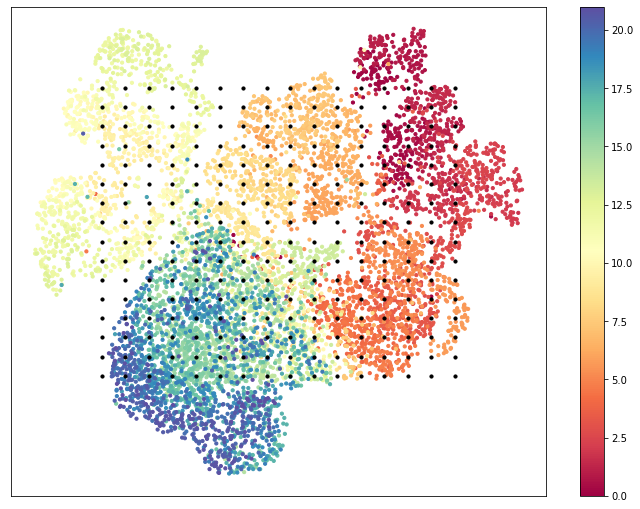

In [72]:
# Let's plot the UMAP projection with a equally spaced target grid
NN = 16
grid = np.array(
    [(i, j) for i in np.linspace(-5, 14, NN) for j in np.linspace(-4, 11, NN)]
)

plt.figure(figsize=(12, 9))
plt.scatter(
    X_umap_small[:, 0],
    X_umap_small[:, 1],
    c=np.linspace(0, 21, len(data)),
    cmap="Spectral",
    s=10,
)
plt.colorbar()
plt.scatter(*grid.T, s=10, c="k")
plt.yticks([])
plt.xticks([]);

In [73]:
# Invert UMAP projection for target grid
%time inv_umap_small = umap_small.inverse_transform(grid)

CPU times: user 9.21 s, sys: 52.5 ms, total: 9.26 s
Wall time: 9.07 s


In [74]:
# Reverse PCA dimensionality reduction
faces_small = np.array(
    [
        p.reshape(data_small.shape[1:]).clip(min=0, max=1)
        for p in pca_small.inverse_transform(inv_umap_small)
    ]
)

In [75]:
# Flip horizontal ordering of faces
faces_small = faces_small.reshape(NN, NN, *faces_small.shape[1:])[:, ::-1, ...].reshape(
    -1, *faces_small.shape[1:]
)

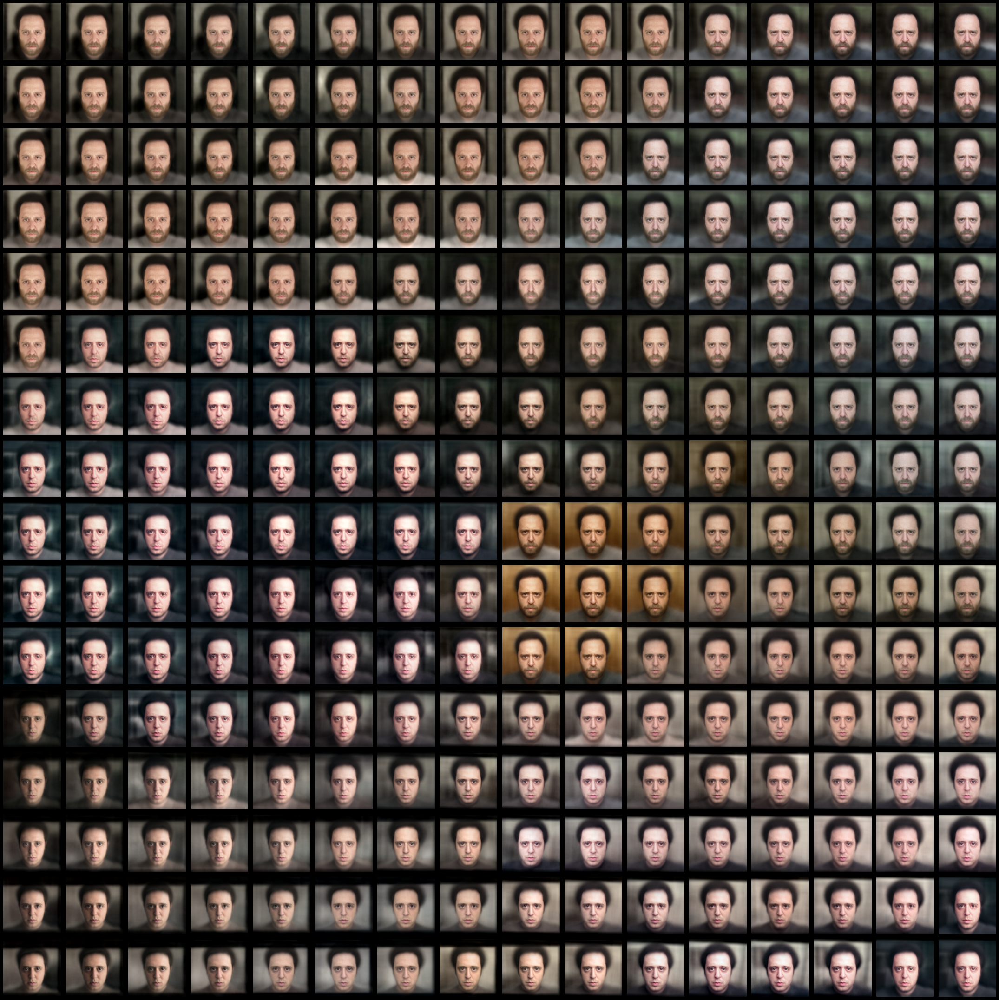

In [76]:
# Plot a grid of certain size of first x images
fig, axes = plt.subplots(16, 16, figsize=(30, 30), facecolor=(0, 0, 0))
for face, ax in zip(faces_small, axes.flatten()):
    ax.imshow(face)
    ax.axis("off")
plt.tight_layout()

### Circle exploration of UMAP projection of grayscale images

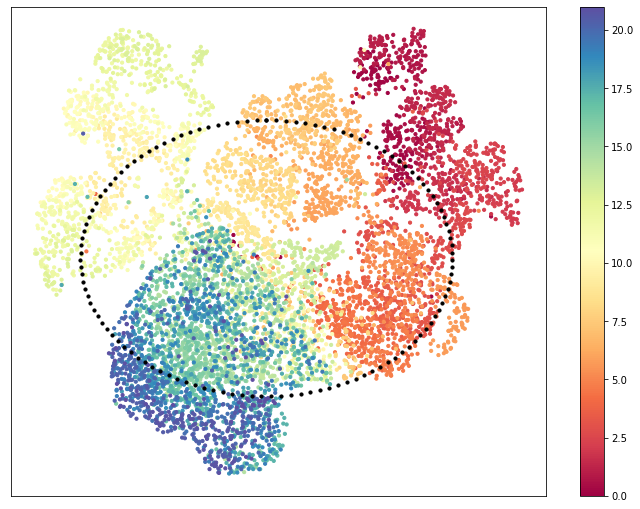

In [77]:
N = 120
circle = np.array([[np.sin(p), np.cos(p)] for p in np.linspace(0, np.pi * 2, N)])
circle *= 8
circle[:, 0] = circle[:, 0] * 1.25
circle[:, 1] = circle[:, 1] * 0.9
circle += X_umap_small.mean(0)

plt.figure(figsize=(12, 9))

plt.scatter(
    X_umap_small[:, 0],
    X_umap_small[:, 1],
    c=np.linspace(0, 21, len(data)),
    cmap="Spectral",
    s=10,
)
plt.colorbar()
plt.scatter(*circle.T, s=10, c="k")

plt.yticks([])
plt.xticks([]);

In [78]:
# Invert UMAP projection for target grid
%time inv_umap_small = umap.inverse_transform(circle)

CPU times: user 7.4 s, sys: 51.2 ms, total: 7.45 s
Wall time: 7.25 s


In [79]:
# Reverse PCA dimensionality reduction
faces_small = np.array(
    [
        p.reshape(data_small.shape[1:]).clip(min=0, max=1)
        for p in pca_small.inverse_transform(inv_umap_small)
    ]
)

In [80]:
# Increase size of images to have nicer output gif
faces_small = np.array(
    [
        cv2.resize(f, tuple(np.array(faces_small.shape[1:3]) * 4))
        for f in tqdm(faces_small)
    ]
)

  0%|          | 0/120 [00:00<?, ?it/s]

In [81]:
# Increase size of images to have nicer output gif
from imageio import mimwrite

mimwrite(
    "noah_umap_circle_colored.gif",
    (255 * faces_small).astype("uint8"),
    format="gif",
    fps=12,
)

In [82]:
from IPython.display import Image

Image(url="noah_umap_circle_colored.gif", width=400)